In [1]:
import geopandas as gpd
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
from scipy.stats import pearsonr, spearmanr
from statsmodels.stats.multitest import fdrcorrection
from statsmodels.tsa.stattools import adfuller, kpss, grangercausalitytests
from tqdm import tqdm
import datetime
import os

# Define dates

In [2]:
from_date = '2020-07-01'
to_date = '2021-12-31'

start_date = datetime.datetime.strptime(from_date,  "%Y-%m-%d")
end_date = datetime.datetime.strptime(to_date,  "%Y-%m-%d")

focus_date = []
focus_date_demand = []
delta = datetime.timedelta(days=1)
while start_date <= end_date:
    focus_date.append(start_date.strftime("%m/%d/%Y"))
    focus_date_demand.append(start_date.strftime("%Y-%m-%d"))
    start_date += delta

In [3]:
# Make a dictionary that has keys as target date and values as the date that should be averaged. 
focus_date_dict = {}
time_delta = [3, 2, 1, 0, -1, -2, -3]

for idx, date in enumerate(focus_date):
    temp_list = []
    for delta in time_delta:
        temp_list.append(
            str(
                (datetime.datetime.strptime(focus_date[idx], "%m/%d/%Y") - datetime.timedelta(days=delta)
                ).strftime("%m/%d/%Y"))
        )
        
    focus_date_dict[date] = temp_list
    
# Manually enter the dates that would have missing values
focus_date_dict['07/01/2020'] = ['07/01/2020', '07/02/2020', '07/03/2020', '07/04/2020']
focus_date_dict['07/02/2020'] = ['07/01/2020', '07/02/2020', '07/03/2020', '07/04/2020', '07/05/2020']
focus_date_dict['07/03/2020'] = ['07/01/2020', '07/02/2020', '07/03/2020', '07/04/2020', '07/05/2020', '07/06/2020']
focus_date_dict['12/29/2021'] = ['12/26/2021', '12/27/2021', '12/28/2021', '12/29/2021', '12/30/2021', '12/31/2021']
focus_date_dict['12/30/2021'] = ['12/27/2021', '12/28/2021', '12/29/2021', '12/30/2021', '12/31/2021']
focus_date_dict['12/31/2021'] = ['12/28/2021', '12/29/2021', '12/30/2021', '12/31/2021']

# Import variables

In [4]:
# Spatial accessibility
access = gpd.read_file("./data/processed_data/ICU_access_measures/ICU_access_county.shp")
access.head(1)

,index,NAME,06/01/2020,06/02/2020,06/03/2020,06/04/2020,06/05/2020,06/06/2020,06/07/2020,06/08/2020,...,12/23/2021,12/24/2021,12/25/2021,12/26/2021,12/27/2021,12/28/2021,12/29/2021,12/30/2021,12/31/2021,geometry
0,48327,Menard,0.48145,0.504673,0.494921,0.359804,0.380861,0.416848,0.445366,0.463968,...,0.057078,0.055447,0.057775,0.058969,0.056747,0.050579,0.046795,0.044798,0.042296,"POLYGON ((-99.77120 30.71079, -99.78240 30.710..."


In [5]:
# Case-fatality ratio over the last 7 days
ratio = gpd.read_file("./data/processed_data/relationship/seven_day_ratio.shp")
ratio.head(1)

,index,NAME,06/01/2020,06/02/2020,06/03/2020,06/04/2020,06/05/2020,06/06/2020,06/07/2020,06/08/2020,...,12/24/2021,12/25/2021,12/26/2021,12/27/2021,12/28/2021,12/29/2021,12/30/2021,12/31/2021,TSA,geometry
0,48327,Menard,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,K,"POLYGON ((-99.77120 30.71079, -99.78240 30.710..."


In [6]:
# COVID death
death = pd.read_csv('./data/processed_data/relationship/daily_death.csv')
death['index'] = death['index'].astype(str)
death = death.drop(columns=['Unnamed: 0'])

# Death 7-days moving mean
death_ = death.copy(deep=True)

for col in focus_date: # Just iterate through column (no rows iteration)
    # Simply assigned the mean value to the entire Series
    death_[col] = death[focus_date_dict[col]].mean(axis=1) 

death_ = death_.drop(columns=[f'06/{num:02}/2020' for num in range(1, 31)]) 
death_.head(1)

,07/01/2020,07/02/2020,07/03/2020,07/04/2020,07/05/2020,07/06/2020,07/07/2020,07/08/2020,07/09/2020,07/10/2020,...,12/25/2021,12/26/2021,12/27/2021,12/28/2021,12/29/2021,12/30/2021,12/31/2021,TSA,index,NAME
0,0.25,0.2,0.166667,0.142857,0.0,0.0,0.0,0.0,0.0,0.142857,...,0.428571,0.428571,0.285714,0.285714,0.333333,0.2,0.25,G,48001,Anderson


In [7]:
# COVID-case 
case = pd.read_excel(os.path.join('./data', 'original_data', 'demand_related', 'Texas COVID-19 New Confirmed Cases by County.xlsx'),
                             sheet_name='New Cases by County 2020',
                             header=2,
                             index_col=0)

case = case.loc['Anderson':'Zavala', focus_date]
case.columns = case.columns.astype(str)

# Remove negative value of confirmed cases. 
# Negative value has replaced with 0
for col in case.columns:
    case[col] = case[col].mask(case[col] < 0, 0)

rename_lookup = dict(zip(focus_date_demand, focus_date))
case = case.rename(columns=rename_lookup, errors='raise')
case = case.reset_index()
case = death[['index', 'NAME']].merge(case, left_on='NAME', right_on='County')
case = case.drop(columns=['County'])
case

# Death 7-days moving mean
case_ = case.copy(deep=True)

for col in focus_date: # Just iterate through column (no rows iteration)
    # Simply assigned the mean value to the entire Series
    case_[col] = case[focus_date_dict[col]].mean(axis=1) 

# case_ = case_.drop(columns=[f'06/{num:02}/2020' for num in range(1, 31)]) 
case_.head(1)


,index,NAME,07/01/2020,07/02/2020,07/03/2020,07/04/2020,07/05/2020,07/06/2020,07/07/2020,07/08/2020,...,12/22/2021,12/23/2021,12/24/2021,12/25/2021,12/26/2021,12/27/2021,12/28/2021,12/29/2021,12/30/2021,12/31/2021
0,48001,Anderson,10.5,8.8,8.0,8.142857,8.714286,8.0,9.571429,14.285714,...,3.857143,3.857143,4.285714,4.285714,6.0,5.714286,6.0,5.833333,6.4,6.25


In [8]:
# ICU bed availability
icu = pd.read_csv(os.path.join('./data', 'processed_data', 'input_files', 'ICU_beds_available_ratio.csv'))
icu = icu.rename(columns={'Unnamed: 0': 'TSA'})
icu.head(1)


,TSA,06/01/2020,06/02/2020,06/03/2020,06/04/2020,06/05/2020,06/06/2020,06/07/2020,06/08/2020,06/09/2020,...,12/22/2021,12/23/2021,12/24/2021,12/25/2021,12/26/2021,12/27/2021,12/28/2021,12/29/2021,12/30/2021,12/31/2021
0,A,0.29913,0.297071,0.293083,0.303644,0.304791,0.301619,0.30404,0.308157,0.320641,...,0.07911,0.081352,0.086207,0.087331,0.091352,0.085749,0.081535,0.080668,0.079602,0.066946


In [9]:
# TSA-County Lookup
tsa = pd.read_json('./data/original_data/tsa_county.json')
tsa['FIPS'] = tsa['FIPS'].astype(str)
tsa.head(1)

,FIPS,TSA,County
0,48011,A,Armstrong


In [10]:
pop = pd.read_csv('./data/processed_data/input_files/estimated_covid_case.csv')
pop = pop[['FIPS', 'County_Pop']].groupby('FIPS').first()
pop = pop.reset_index()
pop['FIPS'] = pop['FIPS'].astype(str)
pop = pop.merge(tsa, on='FIPS')
pop.head()

,FIPS,County_Pop,TSA,County
0,48001,57810.0,G,Anderson
1,48003,18036.0,J,Andrews
2,48005,87322.0,H,Angelina
3,48007,24462.0,U,Aransas
4,48009,8716.0,C,Archer


In [11]:
pearson_dict = dict()

for fips in access['index']:

    acc_ts = access.loc[access['index'] == fips, focus_date].values[0]
    death_ts = death.loc[death['index'] == fips, focus_date].values[0]
    pearr, pearp = pearsonr(acc_ts, death_ts)
    pearson_dict[fips] = dict()
    pearson_dict[fips]["coef"] = pearr
    pearson_dict[fips]["pval"] = pearp
    
# pearson_dict

/Users/zawoon96/opt/anaconda3/envs/sa/lib/python3.8/site-packages/scipy/stats/_stats_py.py:4068: PearsonRConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(PearsonRConstantInputWarning())
/Users/zawoon96/opt/anaconda3/envs/sa/lib/python3.8/site-packages/scipy/stats/_stats_py.py:4068: PearsonRConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(PearsonRConstantInputWarning())
/Users/zawoon96/opt/anaconda3/envs/sa/lib/python3.8/site-packages/scipy/stats/_stats_py.py:4068: PearsonRConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(PearsonRConstantInputWarning())
/Users/zawoon96/opt/anaconda3/envs/sa/lib/python3.8/site-packages/scipy/stats/_stats_py.py:4068: PearsonRConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(PearsonRConstantInputWarning())
/Users/zawoo

In [12]:
coefs = [pearson_dict[ind]["coef"] for ind in access["index"]]
pvals = [pearson_dict[ind]["pval"] for ind in access["index"]]
pearson_df = pd.DataFrame({"index": access["index"], "coefs": coefs, "pvals": pvals})
pearson_df.head()

,index,coefs,pvals
0,48327,-0.084034,4.907182e-02
1,48189,-0.212551,4.997409e-07
2,48011,-0.051580,2.275834e-01
3,48057,-0.072258,9.075610e-02
4,48077,-0.141936,8.530492e-04


In [13]:
pearson_gdf = access[['index', 'geometry']].copy(deep=True)
pearson_gdf = pearson_gdf.merge(pearson_df, on="index")
pearson_gdf.head()

,index,geometry,coefs,pvals
0,48327,"POLYGON ((-99.77120 30.71079, -99.78240 30.710...",-0.084034,4.907182e-02
1,48189,"POLYGON ((-101.73504 33.82864, -101.73507 33.8...",-0.212551,4.997409e-07
2,48011,"POLYGON ((-101.08728 35.02708, -101.08729 35.0...",-0.051580,2.275834e-01
3,48057,"POLYGON ((-96.35229 28.50953, -96.35241 28.508...",-0.072258,9.075610e-02
4,48077,"POLYGON ((-97.97784 33.81417, -97.97784 33.813...",-0.141936,8.530492e-04


<AxesSubplot:>

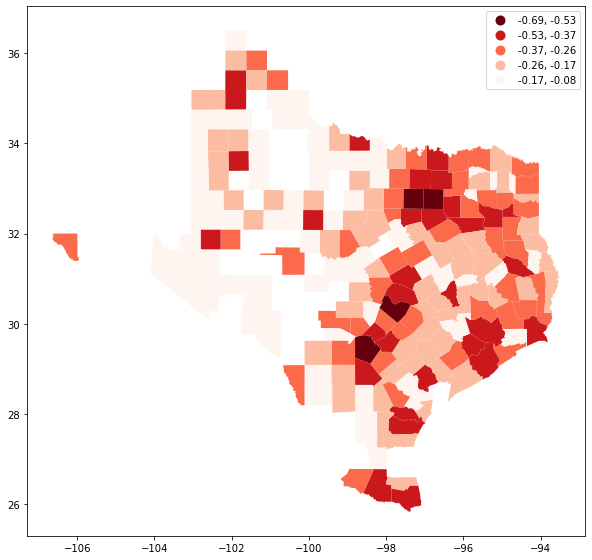

In [14]:
pearson_p05 = pearson_gdf[(pearson_gdf["pvals"] <= 0.05) ]
pearson_p05.plot(column="coefs", figsize=(10, 10), legend=True, cmap='Reds_r', scheme='FisherJenks')

In [15]:
pearson_p05.explore("coefs")

In [16]:
def standardize(ary):
    ary_ = ary.copy()
    ary_ = ary_.astype('float64')
    
    for idx, val in enumerate(ary):
        ary_[idx] = (val - ary.mean()) / ary.std()
        
    return ary_

def normalize(ary):
    ary_ = ary.copy()
    ary_ = ary_.astype('float64')
    
    for idx, val in enumerate(ary):
        ary_[idx] = (val - ary.min()) / (ary.max() - ary.min())
        
    return ary_


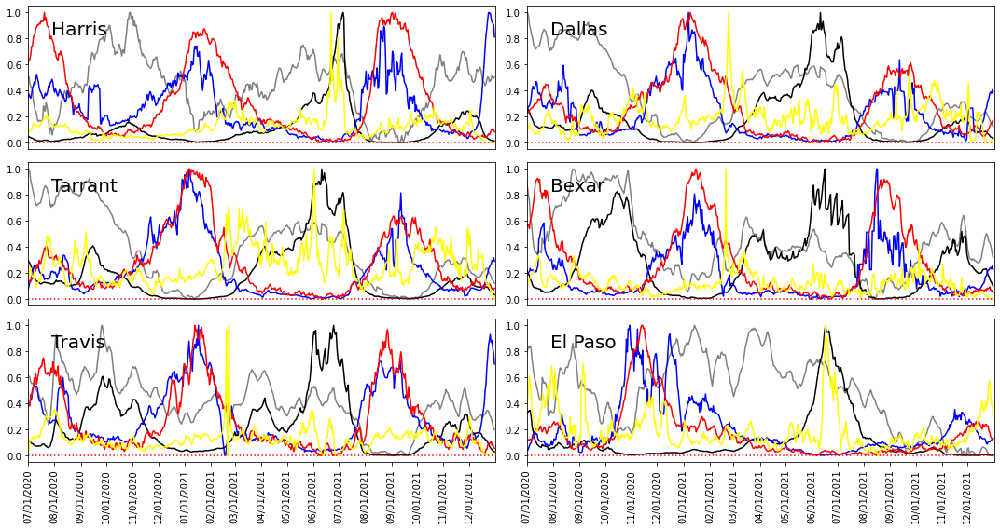

In [17]:
# Plot the trend per county
# Below plot; 
## red: Death, 
## blue: Case (demand of accessibility)
## Grey: ICU availability (supply of accessibility)
## black: Access

county_names = {'Harris': '48201', # Houston
                'Dallas': '48113', # Dallas
                'Tarrant': '48439', # Fort Worth
                'Bexar': '48029', # San Antonio
                'Travis': '48453', # Austin
                'El Paso': '48141'
               }

fig, axes = plt.subplots(3, 2, figsize=(15, 8))

for idx, (cName, cCode) in enumerate(county_names.items()):
    ax = axes.reshape(-1)[idx]
    
    tsa_ = tsa.loc[tsa['FIPS'] == cCode, 'TSA'].values[0]
    icu_ts = icu.loc[icu['TSA'] == tsa_, focus_date].values[0]
    icu_ts = normalize(icu_ts)
    ax.plot(focus_date, icu_ts, label='ICU', color='grey')
#     print(tsa.loc[tsa['FIPS'] == cCode, 'TSA'].values[0])
    
    acc_ts = access.loc[access['index'] == cCode, focus_date].values[0]
    acc_ts = normalize(acc_ts)
    ax.plot(focus_date, acc_ts, label='Access', color='black')
    
    case_ts = case_.loc[case_['index'] == cCode, focus_date].values[0]
    case_ts = normalize(case_ts)
    ax.plot(focus_date, case_ts, label='Case', color='blue')
    
    death_ts = death_.loc[death_['index'] == cCode, focus_date].values[0]
    death_ts = normalize(death_ts)
    ax.plot(focus_date, death_ts, label='Death', color='red')
    
    ratio_ts = ratio.loc[ratio['index']== cCode, focus_date].values[0]
    ratio_ts = normalize(ratio_ts)
    ax.plot(focus_date, ratio_ts, label='Ratio', color='yellow')
    
    ax.text(0.05, 0.9, cName, fontsize=20, ha='left', va='top', transform=ax.transAxes)
    
    if idx <= 3:
        ax.get_xaxis().set_visible(False)
        
    else:
        ax.set_xticks([date for date in focus_date if date[3:5] == '01']) # The locations that ticks will be displayed.
        ax.set_xticklabels([date for date in focus_date if date[3:5] == '01'], rotation=90)
    
    ax.axhline(y=0, color='red', ls=':')
    ax.set_xlim(0, len(focus_date))
    
plt.tight_layout()

In [93]:
import warnings
warnings.filterwarnings("ignore")

pop_m = pop.copy(deep=True)
access_m = access.copy(deep=True)

pop_m = pop_m.set_index('FIPS')
access_m = access_m.set_index('index')



# Create TSA Geometry
access_tsa = access[['index', 'geometry']].copy(deep=True)
access_tsa = access_tsa.merge(tsa, left_on='index', right_on='FIPS')
access_tsa = access_tsa.drop(columns=['index', 'FIPS', 'County'])
access_tsa = access_tsa.dissolve(by='TSA')

case_tsa = access_tsa.copy(deep=True)
death_tsa = access_tsa.copy(deep=True)


tsa_list = tsa['TSA'].unique().tolist()
tsa_list.sort()
tsa_list

for date in tqdm(focus_date):
    
    access_tsa[date] = 0.0
    for t_tsa in tsa_list:
        # List of counties in each TSA
        t_fips = pop.loc[pop['TSA'] == t_tsa, 'FIPS'].tolist()
    
        t_county_access = access_m.loc[access_m.index.isin(t_fips), date] # Accessbility per county
        t_county_pop = pop_m.loc[pop_m.index.isin(t_fips), 'County_Pop'] # Population per county

        t_tsa_pop = pop_m.loc[pop_m.index.isin(t_fips), 'County_Pop'].sum() # Total poppulation in each TSA
        t_tsa_access = sum(t_county_access * t_county_pop) / t_tsa_pop # Estimate of accessibility per TSA
        
        case_tsa.at[t_tsa, date] = case_.loc[case_['index'].isin(t_fips), date].sum()
        death_tsa.at[t_tsa, date] = death_.loc[death_['index'].isin(t_fips), date].sum()
        access_tsa.at[t_tsa, date] = t_tsa_access
        
access_tsa.head(3)

100%|█████████████████████████████████████████| 549/549 [00:44<00:00, 12.20it/s]


,geometry,07/01/2020,07/02/2020,07/03/2020,07/04/2020,07/05/2020,07/06/2020,07/07/2020,07/08/2020,07/09/2020,...,12/22/2021,12/23/2021,12/24/2021,12/25/2021,12/26/2021,12/27/2021,12/28/2021,12/29/2021,12/30/2021,12/31/2021
TSA,,,,,,,,,,,,,,,,,,,,,
A,"POLYGON ((-102.52531 34.50009, -102.52583 34.4...",0.104911,0.099551,0.096186,0.100277,0.102328,0.102234,0.092271,0.086240,0.074252,...,0.007415,0.008055,0.008956,0.009758,0.011047,0.010621,0.010071,0.010473,0.010661,0.009118
B,"POLYGON ((-102.20607 32.52326, -102.20979 32.5...",0.778417,0.678174,0.524259,0.454067,0.446730,0.403565,0.327945,0.267262,0.245198,...,0.023388,0.021617,0.019187,0.017551,0.015503,0.012441,0.013355,0.012581,0.011974,0.010141
C,"POLYGON ((-97.97646 33.88846, -97.97426 33.886...",0.126123,0.123286,0.118754,0.115387,0.113851,0.108940,0.100257,0.100605,0.096422,...,0.005037,0.003779,0.004960,0.007910,0.007494,0.008370,0.007364,0.008219,0.009825,0.007590


In [33]:
case_tsa

,geometry,07/01/2020,07/02/2020,07/03/2020,07/04/2020,07/05/2020,07/06/2020,07/07/2020,07/08/2020,07/09/2020,...,12/22/2021,12/23/2021,12/24/2021,12/25/2021,12/26/2021,12/27/2021,12/28/2021,12/29/2021,12/30/2021,12/31/2021
TSA,,,,,,,,,,,,,,,,,,,,,
A,"POLYGON ((-102.52531 34.50009, -102.52583 34.4...",48.25,39.4,42.500000,51.714286,50.000000,51.285714,90.571429,91.142857,90.857143,...,80.571429,74.285714,72.142857,81.428571,85.714286,87.571429,83.000000,91.000000,107.6,115.00
B,"POLYGON ((-102.20607 32.52326, -102.20979 32.5...",37.00,32.4,32.166667,33.000000,33.000000,34.142857,34.428571,47.571429,74.714286,...,94.428571,94.714286,95.142857,93.142857,93.285714,97.428571,101.714286,102.333333,114.4,123.25
C,"POLYGON ((-97.97646 33.88846, -97.97426 33.886...",11.25,9.8,11.166667,13.428571,11.714286,13.000000,14.000000,13.857143,14.285714,...,28.428571,28.857143,29.000000,31.428571,34.142857,32.000000,35.857143,36.000000,35.6,38.50
D,"POLYGON ((-99.71403 32.08210, -99.71419 32.082...",19.00,21.2,21.833333,22.714286,25.285714,26.714286,26.000000,31.142857,30.000000,...,20.714286,21.000000,22.571429,23.000000,26.000000,28.571429,28.285714,28.833333,32.8,37.25
E,"POLYGON ((-97.61672 32.20376, -97.61690 32.203...",1134.75,1289.8,1440.500000,1464.285714,1552.857143,1767.428571,2053.571429,2208.571429,2098.428571,...,1804.571429,1879.857143,2101.857143,2296.428571,2421.571429,2626.428571,2728.428571,2671.666667,2869.4,2759.00
F,"POLYGON ((-94.15627 32.88078, -94.15647 32.880...",14.00,12.0,12.666667,16.000000,17.857143,20.000000,22.000000,24.000000,24.142857,...,36.428571,34.571429,36.714286,33.142857,35.571429,36.285714,33.142857,35.666667,40.8,43.50
G,"POLYGON ((-95.43571 31.05747, -95.43849 31.055...",95.50,81.4,83.500000,106.000000,119.857143,121.000000,111.428571,122.000000,175.428571,...,70.428571,70.857143,76.714286,79.857143,93.000000,93.285714,91.714286,88.666667,95.4,95.00
H,"POLYGON ((-94.84772 30.49256, -94.84525 30.490...",34.25,29.2,30.000000,32.000000,34.285714,30.142857,29.428571,32.857143,36.857143,...,24.857143,27.000000,27.571429,29.571429,36.000000,36.285714,36.571429,38.000000,40.4,44.25
I,"POLYGON ((-104.92083 30.66162, -104.92540 30.6...",49.25,54.6,72.666667,97.428571,117.142857,123.857143,162.714286,195.000000,214.714286,...,150.714286,119.714286,111.428571,132.428571,135.000000,132.428571,141.714286,147.666667,159.8,162.75


In [30]:
death_tsa

,geometry,07/01/2020,07/02/2020,07/03/2020,07/04/2020,07/05/2020,07/06/2020,07/07/2020,07/08/2020,07/09/2020,...,12/22/2021,12/23/2021,12/24/2021,12/25/2021,12/26/2021,12/27/2021,12/28/2021,12/29/2021,12/30/2021,12/31/2021
TSA,,,,,,,,,,,,,,,,,,,,,
A,"POLYGON ((-102.52531 34.50009, -102.52583 34.4...",0.00,0.0,0.000000,0.000000,0.285714,0.428571,0.428571,0.571429,0.857143,...,5.571429,5.000000,4.285714,4.142857,4.000000,4.142857,4.142857,4.000000,4.2,4.50
B,"POLYGON ((-102.20607 32.52326, -102.20979 32.5...",1.50,1.2,1.333333,1.571429,1.714286,2.000000,1.714286,1.857143,2.714286,...,3.285714,3.714286,4.000000,4.000000,3.857143,4.571429,5.142857,5.666667,5.2,5.00
C,"POLYGON ((-97.97646 33.88846, -97.97426 33.886...",0.25,0.2,0.166667,0.142857,0.142857,0.142857,0.000000,0.142857,0.142857,...,1.142857,1.428571,1.285714,1.285714,0.714286,0.857143,0.857143,1.000000,0.6,0.50
D,"POLYGON ((-99.71403 32.08210, -99.71419 32.082...",1.00,1.0,0.833333,0.714286,0.857143,0.571429,0.571429,0.571429,0.571429,...,2.142857,2.142857,2.571429,2.571429,2.714286,2.142857,2.428571,2.000000,2.4,2.00
E,"POLYGON ((-97.61672 32.20376, -97.61690 32.203...",17.25,16.6,16.833333,17.000000,18.571429,18.000000,18.285714,19.714286,21.285714,...,11.428571,12.714286,14.428571,15.571429,16.000000,16.428571,17.285714,18.666667,18.8,19.00
F,"POLYGON ((-94.15627 32.88078, -94.15647 32.880...",1.75,1.6,1.500000,1.285714,0.857143,0.714286,0.857143,0.857143,0.857143,...,0.142857,0.428571,0.571429,0.714286,0.714286,0.714286,0.714286,0.833333,0.6,0.50
G,"POLYGON ((-95.43571 31.05747, -95.43849 31.055...",1.75,1.6,1.666667,2.142857,1.857143,1.857143,1.428571,1.714286,1.714286,...,2.571429,2.857143,2.571429,2.857143,2.571429,2.428571,2.142857,2.333333,2.4,2.50
H,"POLYGON ((-94.84772 30.49256, -94.84525 30.490...",2.00,2.0,2.166667,1.857143,2.285714,2.000000,2.142857,1.857143,1.571429,...,0.571429,0.428571,0.714286,0.857143,0.714286,0.714286,0.714286,0.833333,1.0,0.75
I,"POLYGON ((-104.92083 30.66162, -104.92540 30.6...",4.25,4.0,4.333333,4.142857,4.428571,4.428571,4.571429,5.000000,5.714286,...,8.285714,8.285714,7.857143,8.000000,6.714286,6.285714,5.285714,4.833333,4.8,4.50


<AxesSubplot:>

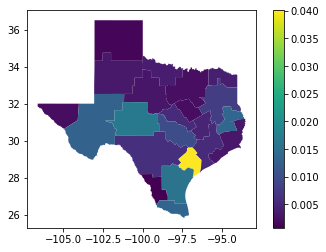

In [207]:
access_tsa.plot('12/01/2020', legend=True)

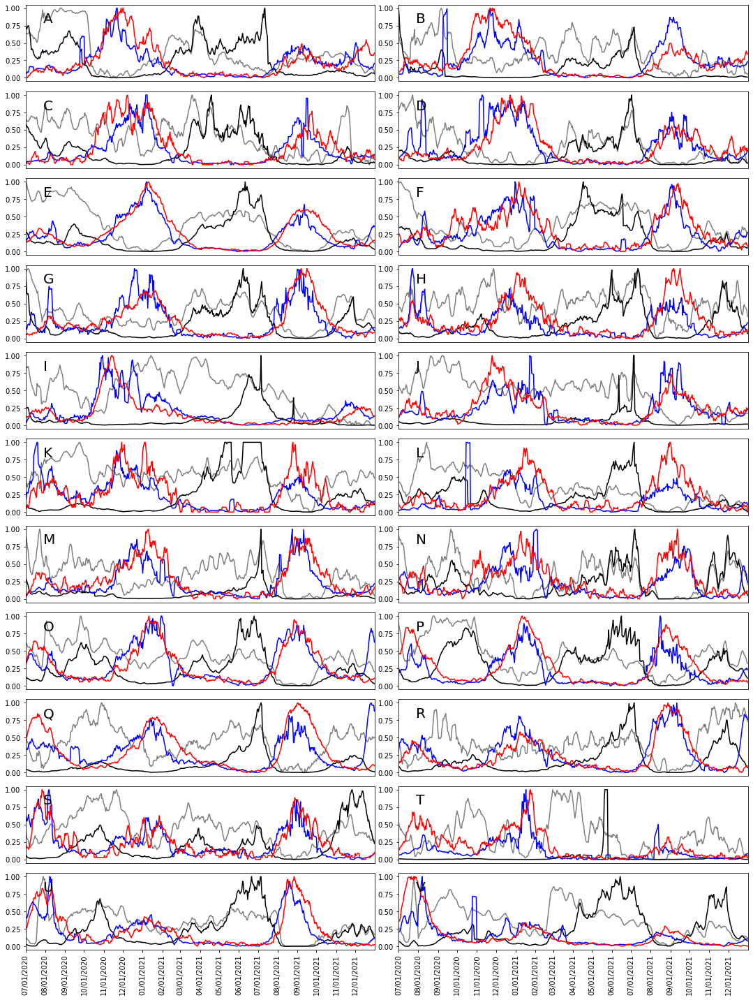

In [94]:
# Plot the trend per TSA

tsa_list = tsa['TSA'].unique().tolist()
tsa_list.sort()
tsa_list

fig, axes = plt.subplots(11, 2, figsize=(15, 20))

for idx, t_tsa in enumerate(tsa_list):
    ax = axes.reshape(-1)[idx]

    t_fips = pop.loc[pop['TSA'] == t_tsa, 'FIPS'].tolist()

    icu_ts = icu.loc[icu['TSA'] == t_tsa, focus_date].values[0]
    icu_ts = normalize(icu_ts)
    ax.plot(focus_date, icu_ts, label='ICU', color='grey')
    
    acc_ts = access_tsa.loc[access_tsa.index == t_tsa, focus_date].values[0]
    acc_ts[acc_ts > 1] = 1
    acc_ts = normalize(acc_ts)
    ax.plot(focus_date, acc_ts, label='Access', color='black')

    case_ts = case_.loc[case_['index'].isin(t_fips), focus_date].sum().values
    case_ts = normalize(case_ts)
    ax.plot(focus_date, case_ts, label='Case', color='blue')

    death_ts = death_.loc[death_['index'].isin(t_fips), focus_date].sum().values
    death_ts = normalize(death_ts)
    ax.plot(focus_date, death_ts, label='Death', color='red')
    
    ax.text(0.05, 0.9, t_tsa, fontsize=20, ha='left', va='top', transform=ax.transAxes)
    ax.set_xlim(0, len(focus_date))
    
    if idx <= 19:
        ax.get_xaxis().set_visible(False)
        
    else:
        ax.set_xticks([date for date in focus_date if date[3:5] == '01']) # The locations that ticks will be displayed.
        ax.set_xticklabels([date for date in focus_date if date[3:5] == '01'], rotation=90)
        
plt.tight_layout()

In [78]:
aaa = pd.read_csv('/Users/zawoon96/Desktop/ST_ICU_Access/data/processed_data/input_files/estimated_covid_case.csv')
aaa['FIPS'] = aaa['FIPS'].astype(str)
aaa.loc[aaa['FIPS'].str.startswith('48479'), focus_date[320:335]]

,05/17/2021,05/18/2021,05/19/2021,05/20/2021,05/21/2021,05/22/2021,05/23/2021,05/24/2021,05/25/2021,05/26/2021,05/27/2021,05/28/2021,05/29/2021,05/30/2021,05/31/2021
5007,1.076232,0.559159,0.258536,0.102212,0.036075,0.0,0.0,0.0,0.0,6.560565,6.560565,6.560565,6.560565,6.560565,6.560565
5008,0.619017,0.321612,0.148702,0.058789,0.020749,0.0,0.0,0.0,0.0,3.773444,3.773444,3.773444,3.773444,3.773444,3.773444
5009,0.838148,0.435462,0.201343,0.079601,0.028094,0.0,0.0,0.0,0.0,5.109240,5.109240,5.109240,5.109240,5.109240,5.109240
5010,0.724674,0.376506,0.174084,0.068824,0.024291,0.0,0.0,0.0,0.0,4.417514,4.417514,4.417514,4.417514,4.417514,4.417514
5011,0.947832,0.492449,0.227692,0.090018,0.031771,0.0,0.0,0.0,0.0,5.777860,5.777860,5.777860,5.777860,5.777860,5.777860
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5063,1.147538,0.596207,0.275666,0.108984,0.038465,0.0,0.0,0.0,0.0,6.995240,6.995240,6.995240,6.995240,6.995240,6.995240
5064,1.446504,0.751536,0.347484,0.137378,0.048486,0.0,0.0,0.0,0.0,8.817699,8.817699,8.817699,8.817699,8.817699,8.817699
5065,0.763051,0.396446,0.183303,0.072469,0.025577,0.0,0.0,0.0,0.0,4.651459,4.651459,4.651459,4.651459,4.651459,4.651459
5066,0.732965,0.380814,0.176075,0.069611,0.024569,0.0,0.0,0.0,0.0,4.468058,4.468058,4.468058,4.468058,4.468058,4.468058


In [99]:
access.loc[access['index'] == '48479', focus_date[320:335]]

,05/17/2021,05/18/2021,05/19/2021,05/20/2021,05/21/2021,05/22/2021,05/23/2021,05/24/2021,05/25/2021,05/26/2021,05/27/2021,05/28/2021,05/29/2021,05/30/2021,05/31/2021
238,0.121193,0.212224,0.41374,0.925175,2.400817,19.288531,19.941606,23.422053,17.87334,0.013332,0.012888,0.013442,0.013406,0.013139,0.012233


In [73]:
t_fips = pop.loc[pop['TSA'] == 'T', 'FIPS'].tolist()
case_.loc[case_['index'].isin(t_fips), ['05/17/2021',
 '05/18/2021',
 '05/19/2021',
 '05/20/2021',
 '05/21/2021',
 '05/22/2021',
 '05/23/2021',
 '05/24/2021',
 '05/25/2021',
 '05/26/2021',
 '05/27/2021',
 '05/28/2021',
 '05/29/2021',
 '05/30/2021',
 '05/31/2021',
'NAME']]

,05/17/2021,05/18/2021,05/19/2021,05/20/2021,05/21/2021,05/22/2021,05/23/2021,05/24/2021,05/25/2021,05/26/2021,05/27/2021,05/28/2021,05/29/2021,05/30/2021,05/31/2021,NAME
123,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.428571,0.428571,0.428571,0.428571,0.428571,0.428571,Jim Hogg
239,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,56.428571,56.428571,56.428571,56.428571,56.428571,56.428571,56.428571,0.000000,0.000000,Webb
252,0.142857,0.142857,0.142857,0.142857,0.142857,0.142857,0.142857,0.142857,0.142857,0.142857,0.142857,0.142857,0.000000,0.428571,0.428571,Zapata


In [70]:
icu.loc[icu['TSA'] == 'T', focus_date[320:330]]

,05/17/2021,05/18/2021,05/19/2021,05/20/2021,05/21/2021,05/22/2021,05/23/2021,05/24/2021,05/25/2021,05/26/2021
19,0.121372,0.111111,0.101333,0.092391,0.091892,0.086253,0.082228,0.08971,0.084881,0.081081


array([[<AxesSubplot:title={'center':'T'}>]], dtype=object)

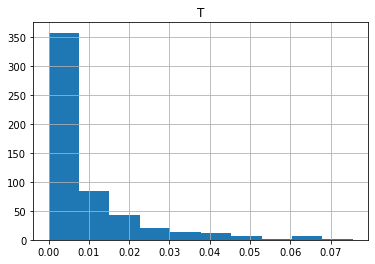

In [84]:
access_tsa.loc[access_tsa.index == 'T', focus_date].T.hist()

In [95]:
access_tsa.loc[access_tsa.index == 'T', focus_date[320:330]]

,05/17/2021,05/18/2021,05/19/2021,05/20/2021,05/21/2021,05/22/2021,05/23/2021,05/24/2021,05/25/2021,05/26/2021
TSA,,,,,,,,,,
T,0.113672,0.198964,0.387783,0.866989,2.24965,18.072993,18.684909,21.946012,16.746997,0.012584


array([[<AxesSubplot:title={'center':'T'}>]], dtype=object)

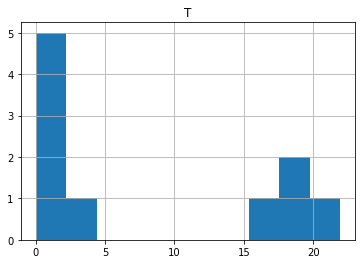

In [66]:
access_tsa.loc[access_tsa.index == 'T', focus_date[320:330]].T.hist()

In [213]:
pearson_tsa_dict = dict()

for idx, t_tsa in enumerate(tsa_list):
# for fips in access['index']:

    acc_ts = access_tsa.loc[access_tsa.index == t_tsa, focus_date].values[0]
    death_ts = death_.loc[death_['index'].isin(t_fips), focus_date].sum().values
    pearr, pearp = pearsonr(acc_ts, death_ts)
    pearson_tsa_dict[t_tsa] = dict()
    pearson_tsa_dict[t_tsa]["coef"] = pearr
    pearson_tsa_dict[t_tsa]["pval"] = pearp
    
# pearson_dict

In [219]:
coefs = [pearson_tsa_dict[t_tsa]["coef"] for t_tsa in tsa_list]
pvals = [pearson_tsa_dict[t_tsa]["pval"] for t_tsa in tsa_list]
pearson_tsa_df = pd.DataFrame({"index": tsa_list, "coefs": coefs, "pvals": pvals})
pearson_tsa_df.head()

,index,coefs,pvals
0,A,0.085086,4.629362e-02
1,B,0.013214,7.573816e-01
2,C,-0.014717,7.307995e-01
3,D,-0.194013,4.670139e-06
4,E,-0.247673,4.058016e-09


In [221]:
pearson_tsa_gdf = access_tsa[['geometry']].copy(deep=True)
pearson_tsa_gdf = pearson_tsa_gdf.reset_index()
pearson_tsa_gdf = pearson_tsa_gdf.rename(columns={'TSA':'index'})
pearson_tsa_gdf = pearson_tsa_gdf.merge(pearson_tsa_df, on="index")
pearson_tsa_gdf.head()

,index,geometry,coefs,pvals
0,A,"POLYGON ((-102.52531 34.50009, -102.52583 34.4...",0.085086,4.629362e-02
1,B,"POLYGON ((-102.20607 32.52326, -102.20979 32.5...",0.013214,7.573816e-01
2,C,"POLYGON ((-97.97646 33.88846, -97.97426 33.886...",-0.014717,7.307995e-01
3,D,"POLYGON ((-99.71403 32.08210, -99.71419 32.082...",-0.194013,4.670139e-06
4,E,"POLYGON ((-97.61672 32.20376, -97.61690 32.203...",-0.247673,4.058016e-09


<AxesSubplot:>

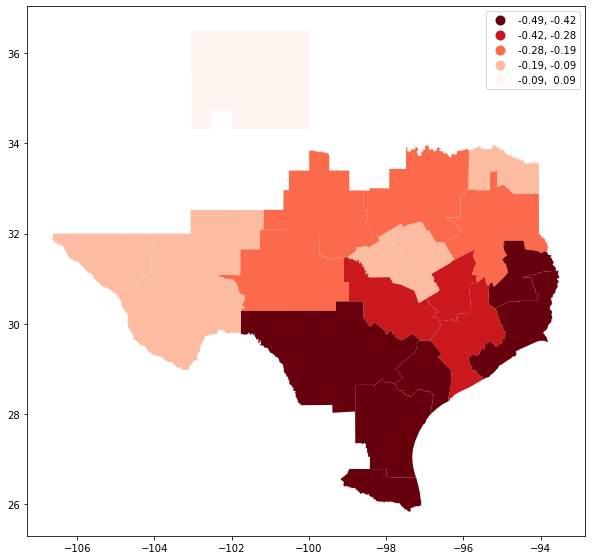

In [223]:
pearson_tsa_p05 = pearson_tsa_gdf[(pearson_tsa_gdf["pvals"] <= 0.05) ]
pearson_tsa_p05.plot(column="coefs", figsize=(10, 10), legend=True, cmap='Reds_r', scheme='FisherJenks')

In [224]:
pearson_tsa_p05.explore('coefs')